In [1]:
import pandas as pd
import numpy as np
from sklearn.neighbors import NearestNeighbors
import time
import sys
import matplotlib.pyplot as plt
from sklearn.cluster import MiniBatchKMeans
import seaborn as sns
import random

random.seed(10)


def get_windows(job,n_neighbors):
    '''
    For each region and each individual cell in dataset, return the indices of the nearest neighbors.
    
    'job:  meta data containing the start time,index of region, region name, indices of region in original dataframe
    n_neighbors:  the number of neighbors to find for each cell
    '''
    start_time,idx,tissue_name,indices = job
    job_start = time.time()
    
    print ("Starting:", str(idx+1)+'/'+str(len(exps)),': ' + exps[idx])

    tissue = tissue_group.get_group(tissue_name)
    to_fit = tissue.loc[indices][[X,Y]].values

#     fit = NearestNeighbors(n_neighbors=n_neighbors+1).fit(tissue[[X,Y]].values)
    fit = NearestNeighbors(n_neighbors=n_neighbors).fit(tissue[[X,Y]].values)
    m = fit.kneighbors(to_fit)
#     m = m[0][:,1:], m[1][:,1:]
    m = m[0], m[1]

    #sort_neighbors
    args = m[0].argsort(axis = 1)
    add = np.arange(m[1].shape[0])*m[1].shape[1]
    sorted_indices = m[1].flatten()[args+add[:,None]]

    neighbors = tissue.index.values[sorted_indices]
   
    end_time = time.time()
   
    print ("Finishing:", str(idx+1)+"/"+str(len(exps)),": "+ exps[idx],end_time-job_start,end_time-start_time)
    return neighbors.astype(np.int32)

### ------------------------

### Fill In:
    -ks = individual window sizes to collect.  
        -This accelerates the process of trying different window sizes by collecting them all in one step.
    -path_to_data:  file path for csv file with x,y cluster information
    -X:  column to use for X location
    -Y:  column to use for Y location
    -reg:  column to use for region (should be different for every tissue)
    -file_type('csv','pickle'):  file type
    -cluster_col : column name of cell type cluster to be used for neighborhoods
    -cellhierpath:  path to cellhier libary (should only have to set once per computer
    -keep_cols:  columns to transfer from original dataframe to dataframe with windows and neighborhoods

In [3]:
ks = [5,10,20] # k=5 means it collects 5 nearest neighbors for each center cell
path_to_data = 'csv.csv' #CA the name does not matter here other than .csv extention, we will read and combine data in the cell below
X = 'X:X'
Y = 'Y:Y'
reg = 'Spots'
file_type = 'csv'

cluster_col = 'ClusterName'
keep_cols = [X,Y,reg,cluster_col]
save_path = ''

### ------------------------

In [4]:
#read in data and do some quick data rearrangement
n_neighbors = max(ks)
assert (file_type=='csv' or file_type =='pickle') #


if file_type == 'pickle':
    cells = pd.read_pickle(path_to_data)
if file_type == 'csv':
    #CA read data to be combined
    cells1 = pd.read_csv('G3_10Spots.csv')
    cells2 = pd.read_csv('G4_10Spots.csv')
    cells3 = pd.read_csv('TAN_10Spots.csv')
    
    #CA combine all data read with the next to line
cells_3groups = [cells1, cells2, cells3]
cells_all = pd.concat(cells_3groups)

cells = pd.concat([cells_all,pd.get_dummies(cells_all[cluster_col])],1)

cells = cells.reset_index() #Uncomment this line if you do any subsetting of dataframe such as removing dirt etc or will throw error at end of next next code block (cell 6)

sum_cols = cells[cluster_col].unique()
values = cells[sum_cols].values

/var/folders/g8/x97t51yd67s3mk1n579wjcgnx3n4z8/T/ipykernel_86972/702676091.py:18: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.
  cells = pd.concat([cells_all,pd.get_dummies(cells_all[cluster_col])],1)


In [5]:
cells.shape #CA this shows number of rows and columns of the final data

(84607, 56)

In [8]:
cells['Spots']

0          G3_3_49
1          G3_3_49
2          G3_3_49
3          G3_3_50
4          G3_3_50
           ...    
84602    TAN_3_124
84603    TAN_3_124
84604    TAN_3_124
84605    TAN_3_124
84606    TAN_3_124
Name: Spots, Length: 84607, dtype: object

In [9]:
#find windows for each cell in each tissue region
tissue_group = cells[[X,Y,reg]].groupby(reg)
exps = list(cells[reg].unique())
tissue_chunks = [(time.time(),exps.index(t),t,a) for t,indices in tissue_group.groups.items() for a in np.array_split(indices,1)] 
tissues = [get_windows(job,n_neighbors) for job in tissue_chunks]

Starting: 5/30 : G3_1_48
Finishing: 5/30 : G3_1_48 0.014813899993896484 0.017149925231933594
Starting: 4/30 : G3_1_51
Finishing: 4/30 : G3_1_51 0.011365890502929688 0.028948068618774414
Starting: 6/30 : G3_1_63
Finishing: 6/30 : G3_1_63 0.010315179824829102 0.039381980895996094
Starting: 7/30 : G3_1_79
Finishing: 7/30 : G3_1_79 0.010501861572265625 0.05003690719604492
Starting: 9/30 : G3_1_80
Finishing: 9/30 : G3_1_80 0.012038946151733398 0.06221508979797363
Starting: 8/30 : G3_1_81
Finishing: 8/30 : G3_1_81 0.010828018188476562 0.07413601875305176
Starting: 10/30 : G3_1_96
Finishing: 10/30 : G3_1_96 0.009501934051513672 0.08376884460449219
Starting: 1/30 : G3_3_49
Finishing: 1/30 : G3_3_49 0.012251853942871094 0.09613895416259766
Starting: 2/30 : G3_3_50
Finishing: 2/30 : G3_3_50 0.010505914688110352 0.1069481372833252
Starting: 3/30 : G3_3_64
Finishing: 3/30 : G3_3_64 0.009366750717163086 0.11632680892944336
Starting: 16/30 : G4_1_125
Finishing: 16/30 : G4_1_125 0.012137889862060547 

In [10]:
#for each cell and its nearest neighbors, reshape and count the number of each cell type in those neighbors.
out_dict = {}
for k in ks:
    for neighbors,job in zip(tissues,tissue_chunks):

        chunk = np.arange(len(neighbors))#indices
        tissue_name = job[2]
        indices = job[3]
        window = values[neighbors[chunk,:k].flatten()].reshape(len(chunk),k,len(sum_cols)).sum(axis = 1)
        out_dict[(tissue_name,k)] = (window.astype(np.float16),indices)

#concatenate the summed windows and combine into one dataframe for each window size tested.
windows = {}
for k in ks:
   
    window = pd.concat([pd.DataFrame(out_dict[(exp,k)][0],index = out_dict[(exp,k)][1].astype(int),columns = sum_cols) for exp in exps],0)
    window = window.loc[cells.index.values]
    window = pd.concat([cells[keep_cols],window],1)
    windows[k] = window

/var/folders/g8/x97t51yd67s3mk1n579wjcgnx3n4z8/T/ipykernel_86972/2968920925.py:16: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.
  window = pd.concat([pd.DataFrame(out_dict[(exp,k)][0],index = out_dict[(exp,k)][1].astype(int),columns = sum_cols) for exp in exps],0)
/var/folders/g8/x97t51yd67s3mk1n579wjcgnx3n4z8/T/ipykernel_86972/2968920925.py:18: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.
  window = pd.concat([cells[keep_cols],window],1)
/var/folders/g8/x97t51yd67s3mk1n579wjcgnx3n4z8/T/ipykernel_86972/2968920925.py:16: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.
  window = pd.concat([pd.DataFrame(out_dict[(exp,k)][0],index = out_dict[(exp,k)][1].astype(int),columns = sum_cols) for exp in exps],0)
/var/folders/g8/x97t51yd67s3mk1n579wjcgnx3n4z8/T/ipykernel_86

### ------------------------

### Fill In:
    -k:  window_size (needs to be in ks (saved above))
    -n_neighborhoods:  number of neighborhoods to find

In [11]:
# 0 TAN
# 3 G3
# 4 G4

In [12]:
k = 10
n_neighborhoods = 10
neighborhood_name = "neighborhood"+str(k)
k_centroids = {}

In [13]:
windows2 = windows[10]
# windows2[cluster_col] = cells[cluster_col]

km = MiniBatchKMeans(n_clusters = n_neighborhoods,random_state=0)

labelskm = km.fit_predict(windows2[sum_cols].values)
k_centroids[k] = km.cluster_centers_
cells['neighborhood10'] = labelskm
cells[neighborhood_name] = cells[neighborhood_name].astype('category')

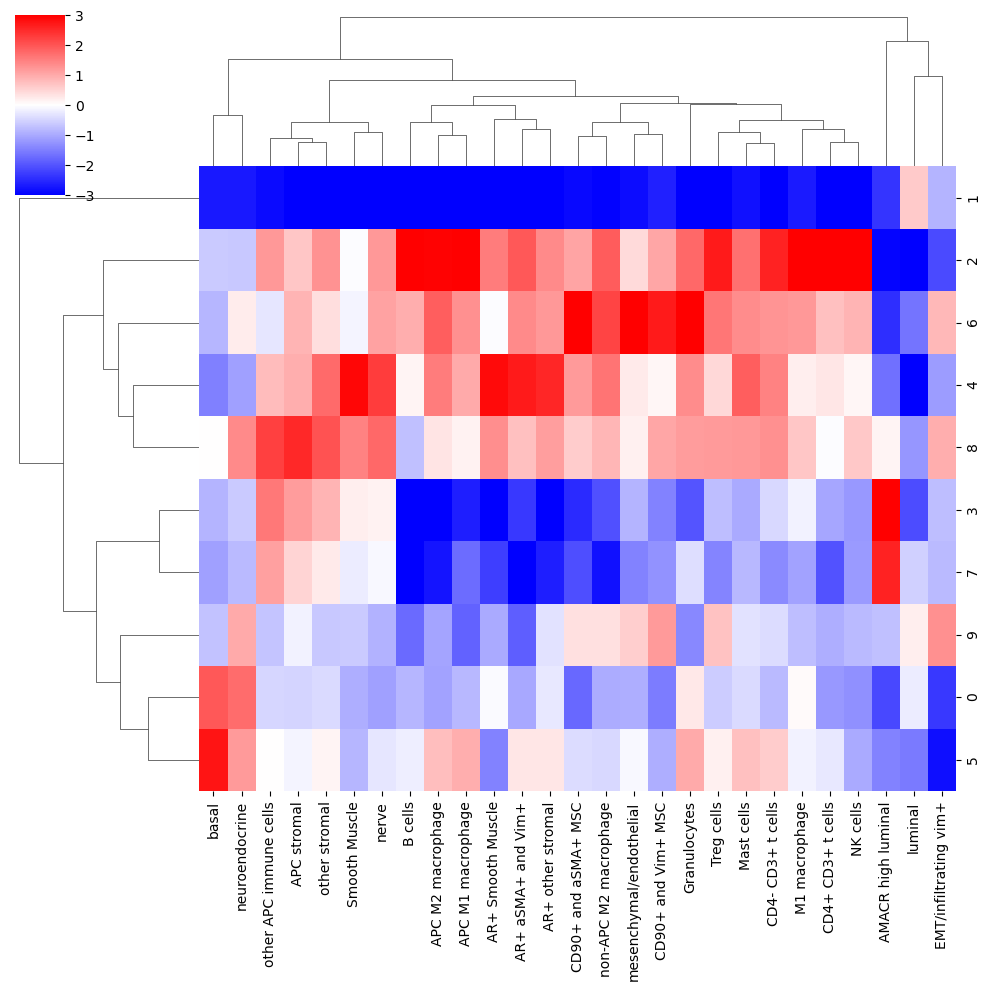

In [18]:
# this plot shows the types of cells (ClusterIDs) in the different niches 
k_to_plot = 10
niche_clusters = (k_centroids[k_to_plot])
tissue_avgs = values.mean(axis = 0)
fc = np.log2(((niche_clusters+tissue_avgs)/(niche_clusters+tissue_avgs).sum(axis = 1, keepdims = True))/tissue_avgs)
fc = pd.DataFrame(fc,columns = sum_cols)
#s=sns.clustermap(fc.loc[[0,2,3,4,5,6,7,8,9],cell_order], vmin =-3,vmax = 3,cmap = 'bwr',row_cluster = False)
s=sns.clustermap(fc.loc[[0,1,2,3,4,5,6,7,8,9],], vmin =-3,vmax = 3,cmap = 'bwr',row_cluster = True)
s.savefig("celltypes_perniche_10_10spots.pdf")

In [19]:
cells['neighborhood10'] = cells['neighborhood10'].astype('category')

In [61]:
cells['neighborhood10'] = cells['neighborhood10'].astype('category')
g3_cn = sns.lmplot(data = cells[cells['groups']==3],x = 'X:X',y='Y:Y',hue = 'neighborhood10',palette = 'bright',height = 50,col = reg,col_wrap = 3,fit_reg = False)
g3_cn.savefig("G3_CN_10spots.pdf")

In [62]:
cells['neighborhood10'] = cells['neighborhood10'].astype('category')
g4_cn=sns.lmplot(data = cells[cells['groups']==4],x = 'X:X',y='Y:Y',hue = 'neighborhood10',palette = 'bright',height = 50,col = reg,col_wrap = 3,fit_reg = False)
g4_cn.savefig("G4_CN_10spots.pdf")

In [60]:
cells['neighborhood10'] = cells['neighborhood10'].astype('category')
tan_cn = sns.lmplot(data = cells[cells['groups']==0],x = 'X:X',y='Y:Y',hue = 'neighborhood10',palette = 'bright',height = 50,col = reg,col_wrap = 3,fit_reg = False)
tan_cn.savefig("TAN_CN_10spots.ppdf")

###### -------------------------------

In [23]:
set(cells['groups'])

{0, 3, 4}

In [24]:
set(cells[cells['groups']==3]['Region'])

{'19142-6', '33548-6'}

In [27]:
set(cells[cells['groups']==4]['Region'])

{'57494-6', '57658-6'}

In [28]:
set(cells[cells['groups']==0]['Region'])

{'30411-6', '31022-6', '31480-6'}

In [26]:
set(cells['patients'])

{1, 2, 3, 4, 5, 11, 13}

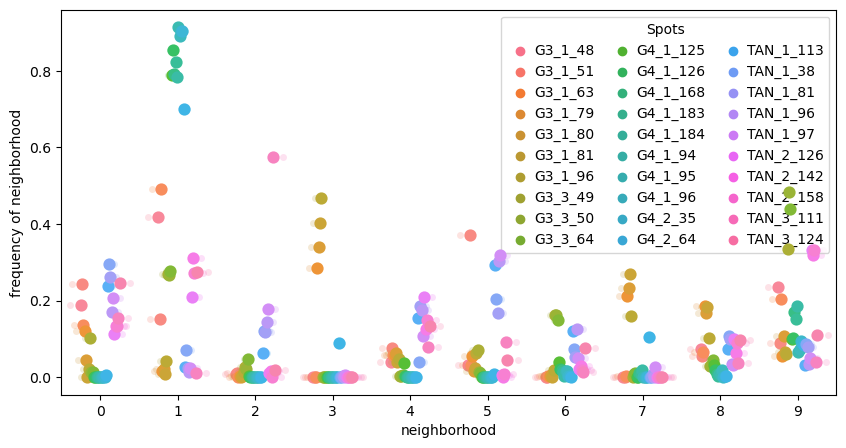

In [51]:
#plot for each group and each patient the percent of total cells allocated to each neighborhood
fc = cells.groupby(['Spots','groups']).apply(lambda x: x['neighborhood10'].value_counts(sort = False,normalize = True))
                             
colors = ["#74c476",
         "#a1d99b",
         "#c7e9c0",
         "#08306b",
         "#08519c",
         "#2171b5",
         "#9ECAE1",
         "#6baed6",
         "#4292c6",
         "#a50f15",
         "#cb181d",
         "#ef3b2c",
         "#fb6a4a"]
customPalette = sns.set_palette(sns.color_palette(colors))

fc.columns = range(10)
melt = pd.melt(fc.reset_index(),id_vars = ['Spots', 'groups'])
melt = melt.rename(columns = {'variable':'neighborhood','value':'frequency of neighborhood'})
f,ax = plt.subplots(figsize = (10,5))
sns.stripplot(data = melt, hue = 'Spots',dodge = True,alpha = .2,x ='neighborhood', y ='frequency of neighborhood')
sns.pointplot(data = melt, hue = 'Spots',dodge = .5,join = False,x ='neighborhood', 
              y ='frequency of neighborhood')

handles, labels = ax.get_legend_handles_labels()
ax.legend(handles[:30], labels[:30], title="Spots", #CA changed labels[:3] to ['TAN', 'G3', 'G4']
          handletextpad=0, columnspacing=1,
          loc="upper right", ncol=3, frameon=True)
#plt.savefig('neighborhood_comparison_by_patient.pdf')

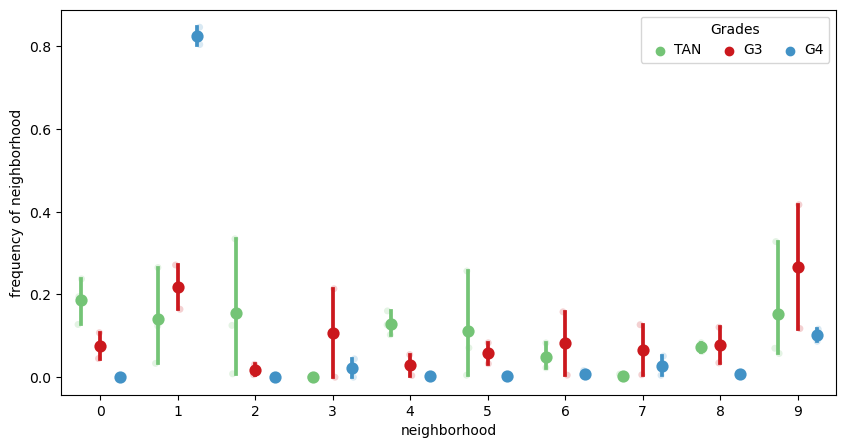

In [56]:
#plot for each group and each patient the percent of total cells allocated to each neighborhood
fc = cells.groupby(['patients','groups']).apply(lambda x: x['neighborhood10'].value_counts(sort = False,normalize = True))

fc.columns = range(10)
melt = pd.melt(fc.reset_index(),id_vars = ['patients','groups'])
melt = melt.rename(columns = {'variable':'neighborhood','value':'frequency of neighborhood'})
f,ax = plt.subplots(figsize = (10,5))
sns.stripplot(data = melt, hue = 'groups',dodge = True,alpha = .2,x ='neighborhood', y ='frequency of neighborhood', palette=["#74c476", "#cb181d", "#4292c6"])
sns.pointplot(data = melt, hue = 'groups',dodge = .5,join = False,x ='neighborhood', y ='frequency of neighborhood', palette=["#74c476", "#cb181d", "#4292c6"])

handles, labels = ax.get_legend_handles_labels()
ax.legend(handles[:3], ['TAN', 'G3', 'G4'], title="Grades", #CA changed labels[:3] to ['TAN', 'G3', 'G4']
          handletextpad=0, columnspacing=1,
          loc="upper right", ncol=3, frameon=True)
plt.savefig('neighborhood_comparison_by_grade_10spots.pdf')

In [63]:
#t-test to evaluate if any neighborhood is enriched in one group TAN vs G3
from scipy.stats import ttest_ind
for i in range(10):
    n2 = melt[melt['neighborhood']==i]
    print (i,'    ',ttest_ind(n2[n2['groups']==0]['frequency of neighborhood'],n2[n2['groups']==3]['frequency of neighborhood']))

0      Ttest_indResult(statistic=2.321441530877862, pvalue=0.10294856647279418)
1      Ttest_indResult(statistic=-0.8035230318489436, pvalue=0.48044251386783937)
2      Ttest_indResult(statistic=1.1114369708965115, pvalue=0.34743952074869244)
3      Ttest_indResult(statistic=-1.3340401568088363, pvalue=0.27442022076077494)
4      Ttest_indResult(statistic=3.507168423296955, pvalue=0.03927777930599274)
5      Ttest_indResult(statistic=0.5341677341864842, pvalue=0.6302742597770513)
6      Ttest_indResult(statistic=-0.5314365830852308, pvalue=0.6319498336672542)
7      Ttest_indResult(statistic=-1.413910025690257, pvalue=0.25229583745074075)
8      Ttest_indResult(statistic=-0.17064710670588623, pvalue=0.8753611701788375)
9      Ttest_indResult(statistic=-0.7249731741733604, pvalue=0.5208982747625305)


In [58]:
#t-test to evaluate if any neighborhood is enriched in one group TAN vs G4
from scipy.stats import ttest_ind
for i in range(10):
    n2 = melt[melt['neighborhood']==i]
    print (i,'    ',ttest_ind(n2[n2['groups']==0]['frequency of neighborhood'],n2[n2['groups']==4]['frequency of neighborhood']))

0      Ttest_indResult(statistic=4.469069725906155, pvalue=0.020873544808187275)
1      Ttest_indResult(statistic=-7.739919070001034, pvalue=0.004484974122533314)
2      Ttest_indResult(statistic=1.2641014080413715, pvalue=0.29548219874061626)
3      Ttest_indResult(statistic=-1.303874491306322, pvalue=0.28330464651440973)
4      Ttest_indResult(statistic=5.87078196209179, pvalue=0.009857876064366177)
5      Ttest_indResult(statistic=1.1158717873926143, pvalue=0.3458076344974276)
6      Ttest_indResult(statistic=1.704473792163097, pvalue=0.18683966789388629)
7      Ttest_indResult(statistic=-1.4414619738034593, pvalue=0.24511468712095758)
8      Ttest_indResult(statistic=7.637427924759636, pvalue=0.004660739460662483)
9      Ttest_indResult(statistic=0.43933225715292806, pvalue=0.6901408607430002)


In [59]:
#t-test to evaluate if any neighborhood is enriched in one group G3 vs G4
from scipy.stats import ttest_ind
for i in range(10):
    n2 = melt[melt['neighborhood']==i]
    print (i,'    ',ttest_ind(n2[n2['groups']==3]['frequency of neighborhood'],n2[n2['groups']==4]['frequency of neighborhood']))

0      Ttest_indResult(statistic=2.389957599301305, pvalue=0.13938368147964625)
1      Ttest_indResult(statistic=-10.576023551558157, pvalue=0.008822227445535517)
2      Ttest_indResult(statistic=1.4637823006833148, pvalue=0.2808211313006305)
3      Ttest_indResult(statistic=0.7760199334222578, pvalue=0.5189369927227278)
4      Ttest_indResult(statistic=1.0439285385554975, pvalue=0.406109314316218)
5      Ttest_indResult(statistic=2.192068511215191, pvalue=0.15969912810545245)
6      Ttest_indResult(statistic=0.9482579621878648, pvalue=0.44308627371156484)
7      Ttest_indResult(statistic=0.5940196986355509, pvalue=0.6127398057140335)
8      Ttest_indResult(statistic=1.6209844853784239, pvalue=0.24646854097362533)
9      Ttest_indResult(statistic=1.1017763070669933, pvalue=0.3854227160047212)
